# 4th homework for deep learning subject.

In [1]:
import numpy as np
import keras
from keras import models
from keras import layers
from keras import optimizers
from keras.preprocessing.image import ImageDataGenerator, load_img
import matplotlib
matplotlib.use('TkAgg')
import matplotlib.pyplot as plt
%matplotlib inline

Using TensorFlow backend.


Import own python files

In [2]:
import data_collector
from utility_methods import collect_and_separate_labels, collect_labels

O:\ProgrammingSoftwares\anaconda_projects\deep_learning_homework4\utility_methods.py:3: UserWarning: matplotlib.pyplot as already been imported, this call will have no effect.
  matplotlib.use('Agg')


To download the 2 chosen classes i've created a DataCollector class, which load up the OpenImageDataset csv-s and can find and collect each class images. Downloading links for each file:
 - https://storage.googleapis.com/openimages/2018_04/train/train-annotations-human-imagelabels.csv
 - https://storage.googleapis.com/openimages/2018_04/validation/validation-annotations-human-imagelabels.csv
 - https://storage.googleapis.com/openimages/2018_04/test/test-annotations-human-imagelabels.csv
 - https://storage.googleapis.com/openimages/2018_04/image_ids_and_rotation.csv
 - https://storage.googleapis.com/openimages/2018_04/class-descriptions.csv

In [3]:
train_labl_path = 'O:/ProgrammingSoftwares/anaconda_projects/dp_nagyhazi/data/train-annotations-human-imagelabels.csv'
valid_labl_path = 'O:/ProgrammingSoftwares/anaconda_projects/dp_nagyhazi/data/validation-annotations-human-imagelabels.csv'
test_labl_path = 'O:/ProgrammingSoftwares/anaconda_projects/dp_nagyhazi/data/test-annotations-human-imagelabels.csv'
class_desc_path = 'O:/ProgrammingSoftwares/anaconda_projects/dp_nagyhazi/data/class-descriptions.csv'
image_id_path = 'O:/ProgrammingSoftwares/anaconda_projects/dp_nagyhazi/data/image_ids_and_rotation.csv'


data_hl = data_collector.DataCollector()
data_hl.load_datas(image_id_path, train_labl_path, valid_labl_path, test_labl_path, class_desc_path)

Download Human and Animal classes for training.

In [5]:
label_names = ['Human', 'Animal']
# Max_img property to stop downloading after exceeding this limit for each class.
collect_and_separate_labels(data_hl, image_root_folder, label_names, max_img = 600)

O:/ProgrammingSoftwares/anaconda_projects/deep_learning_homework4/data/Human/
O:/ProgrammingSoftwares/anaconda_projects/deep_learning_homework4/data/Animal/


KeyboardInterrupt: 

In [3]:
image_root_folder = 'O:/ProgrammingSoftwares/anaconda_projects/deep_learning_homework4/data/'

In [4]:
from keras.applications.vgg16 import VGG16
image_size = 224
vgg_conv = VGG16(include_top = False, weights = 'imagenet', input_shape=(image_size, image_size, 3))
vgg_conv.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

### Freeze all layers, first i want to train only on the output layer(s).

In [21]:
for layer in vgg_conv.layers:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)

<keras.engine.input_layer.InputLayer object at 0x000001BEA16E8588> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA16E8BE0> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA16E8A58> False
<keras.layers.pooling.MaxPooling2D object at 0x000001BEA26F8320> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA26F8AC8> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA2727710> False
<keras.layers.pooling.MaxPooling2D object at 0x000001BEA273A2E8> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA273A9E8> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA27643C8> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA277B780> False
<keras.layers.pooling.MaxPooling2D object at 0x000001BEA2792390> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA2792C50> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA27BB470> False
<keras.layers.convolutional.Conv2D object at 0x000001BEA27D37F0> False
<ker

In [7]:
# Create the classifier
model = models.Sequential()
 
# Add the vgg convolutional base model
model.add(vgg_conv)
 
# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(2, activation='softmax'))
 
# Show a summary of the model. Check the number of trainable parameters
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_2 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 1024)              25691136  
_________________________________________________________________
dropout_2 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_4 (Dense)              (None, 2)                 2050      
Total params: 40,407,874
Trainable params: 25,693,186
Non-trainable params: 14,714,688
_________________________________________________________________


## Prepare data generator classes and preprocessing methods  
After downloading the images i separated into 3 folders: train,valid,test.

In [13]:
train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=20,
      width_shift_range=0.2,
      height_shift_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest')
 
validation_datagen = ImageDataGenerator(rescale=1./255)
# I moved images into separated folders, 
train_dir = 'O:/ProgrammingSoftwares/anaconda_projects/deep_learning_homework4/train'
validation_dir = 'O:/ProgrammingSoftwares/anaconda_projects/deep_learning_homework4/valid/'
test_dir = 'O:/ProgrammingSoftwares/anaconda_projects/deep_learning_homework4/test/'

# Change the batchsize according to your system RAM
train_batchsize = 1
val_batchsize = 1
 
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')
 
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

test_generator = validation_datagen.flow_from_directory(
        test_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

Found 800 images belonging to 2 classes.
Found 200 images belonging to 2 classes.
Found 200 images belonging to 2 classes.


In [15]:
# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])
# Train the model
history = model.fit_generator(
      train_generator,
      steps_per_epoch=train_generator.samples/train_generator.batch_size,
      epochs=5,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)
 
# Save the model
model.save('pretrained.h5')

Epoch 1/5
800/800 [==============================] - 62s 78ms/step - loss: 1.2975 - acc: 0.6075 - val_loss: 0.7741 - val_acc: 0.7150
Epoch 2/5
800/800 [==============================] - 59s 73ms/step - loss: 0.8438 - acc: 0.7087 - val_loss: 0.5611 - val_acc: 0.7750
Epoch 3/5
800/800 [==============================] - 58s 73ms/step - loss: 0.8323 - acc: 0.7400 - val_loss: 0.4298 - val_acc: 0.8300
Epoch 4/5
800/800 [==============================] - 58s 73ms/step - loss: 0.7989 - acc: 0.7550 - val_loss: 0.4272 - val_acc: 0.8350
Epoch 5/5
800/800 [==============================] - 59s 74ms/step - loss: 0.7283 - acc: 0.7875 - val_loss: 0.5425 - val_acc: 0.8250


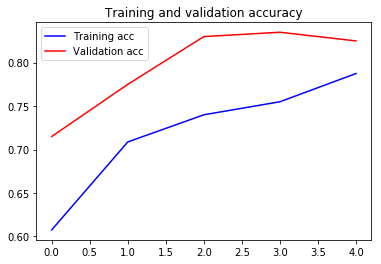

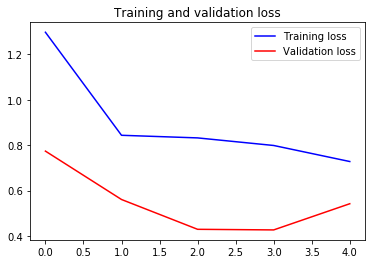

In [17]:
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
 
epochs = range(len(acc))
 
plt.plot(epochs, acc, 'g', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()
 
plt.figure()
 
plt.plot(epochs, loss, 'g', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
 
plt.show()

In [19]:
#unfreeze the top conv layers
for layer in vgg_conv.layers[:-4]:
    layer.trainable = True

In [20]:
# Train the model
history2 = model.fit_generator(
      train_generator,
      steps_per_epoch=train_generator.samples/train_generator.batch_size,
      epochs=5,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)
 
# Save the model
model.save('full_trained.h5')

Epoch 1/5
  2/800 [..............................] - ETA: 1:11 - loss: 0.0983 - acc: 1.0000

O:\ProgrammingSoftwares\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


800/800 [==============================] - 59s 73ms/step - loss: 0.7214 - acc: 0.7913 - val_loss: 0.5505 - val_acc: 0.8200
Epoch 2/5
800/800 [==============================] - 58s 73ms/step - loss: 0.7743 - acc: 0.7712 - val_loss: 0.3837 - val_acc: 0.8600
Epoch 3/5
800/800 [==============================] - 59s 73ms/step - loss: 0.7398 - acc: 0.7988 - val_loss: 0.3933 - val_acc: 0.8550
Epoch 4/5
800/800 [==============================] - 59s 74ms/step - loss: 0.7539 - acc: 0.7963 - val_loss: 0.4869 - val_acc: 0.8400
Epoch 5/5
800/800 [==============================] - 59s 73ms/step - loss: 0.6826 - acc: 0.7975 - val_loss: 0.4777 - val_acc: 0.8600


## Visualize the learning curve

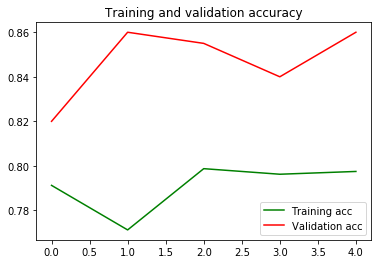

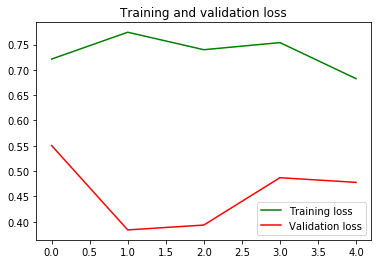

In [22]:
acc = history2.history['acc']
val_acc = history2.history['val_acc']
loss = history2.history['loss']
val_loss = history2.history['val_loss']
 
epochs = range(len(acc))
 
plt.plot(epochs, acc, 'g', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()
 
plt.figure()
 
plt.plot(epochs, loss, 'g', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
 
plt.show()

## Evaluate the precision

200/200 [==============================] - 5s 25ms/step
No of errors = 52/200


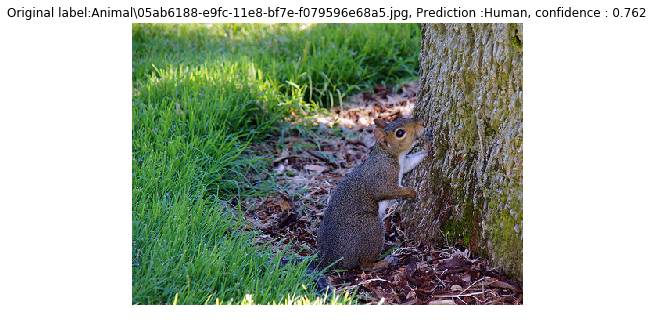

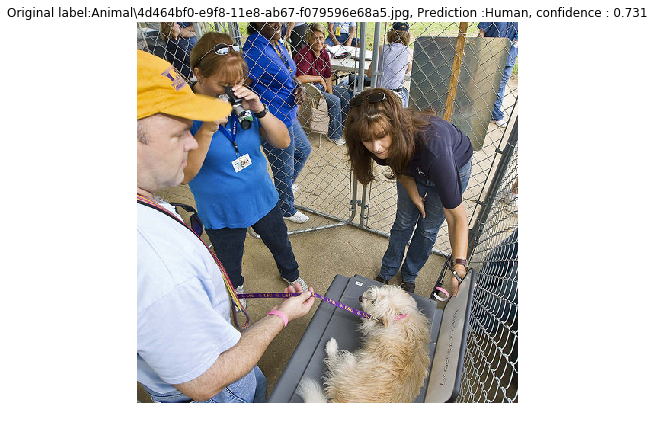

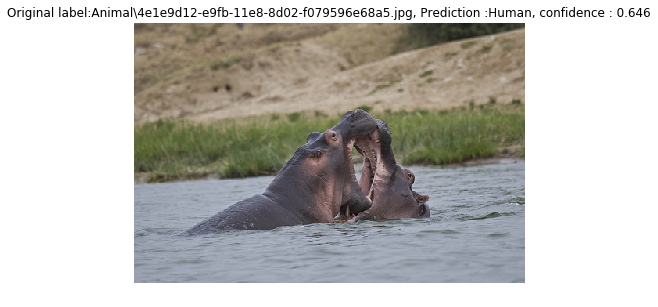

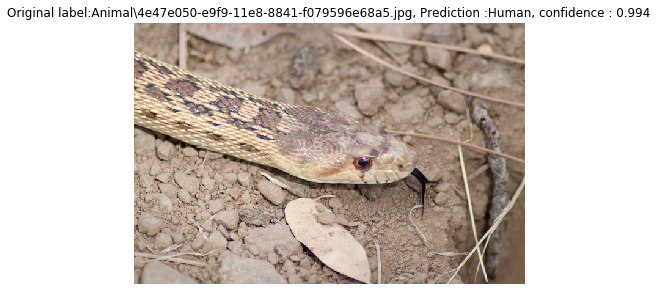

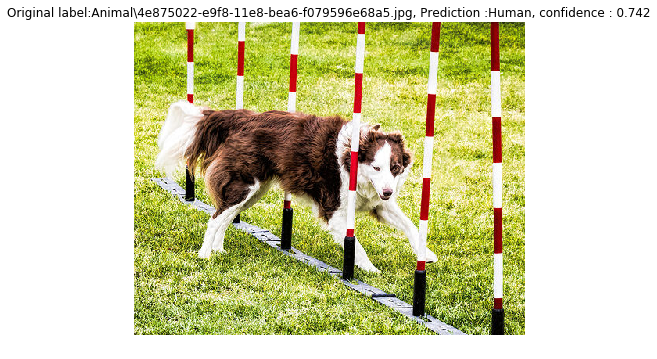

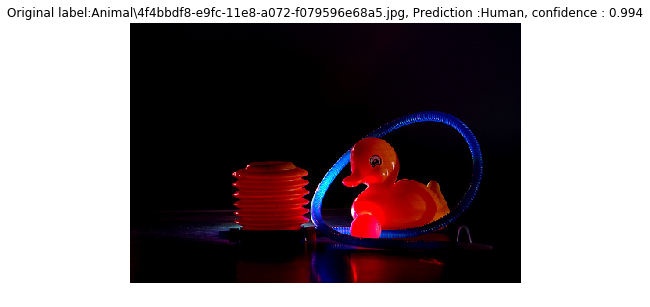

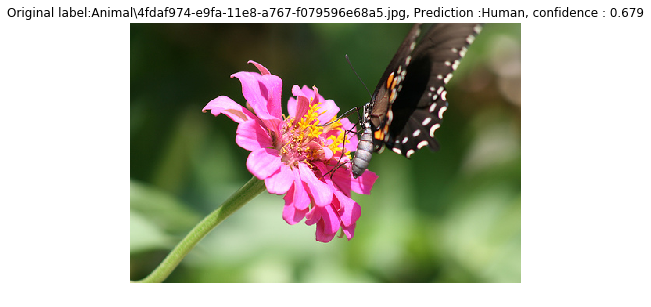

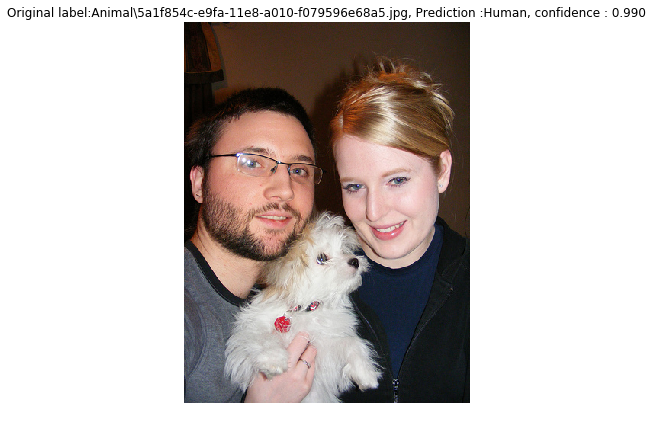

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


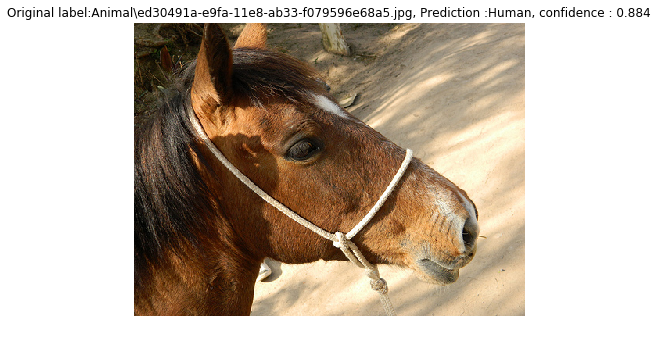

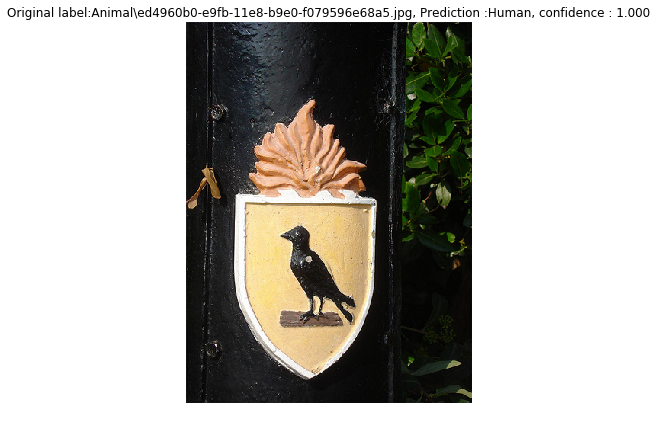

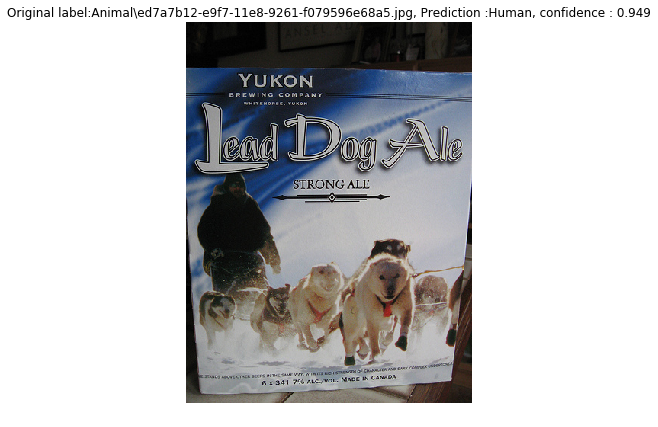

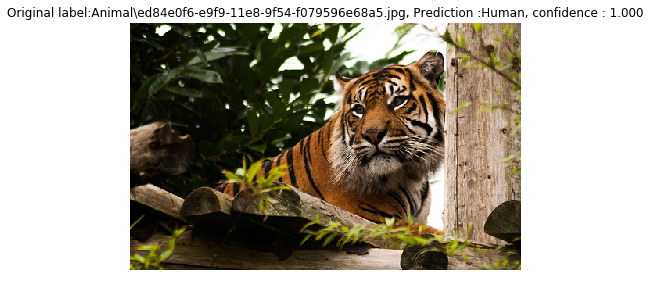

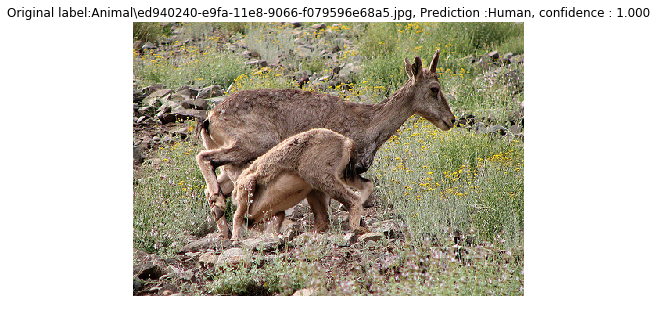

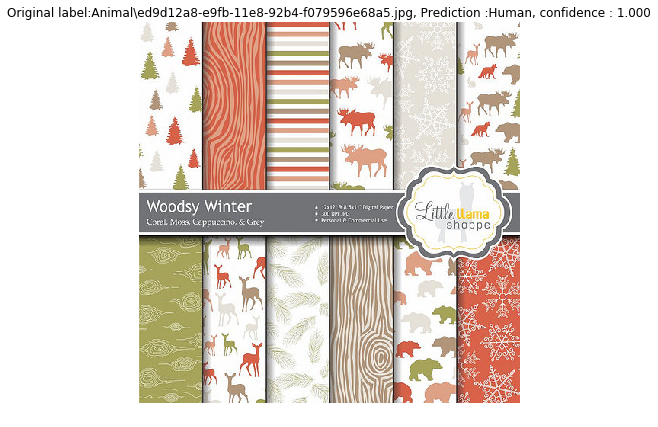

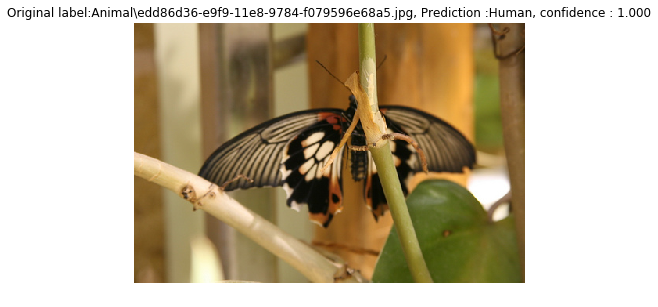

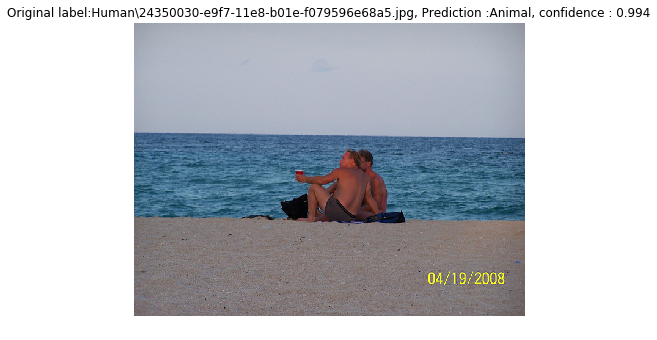

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


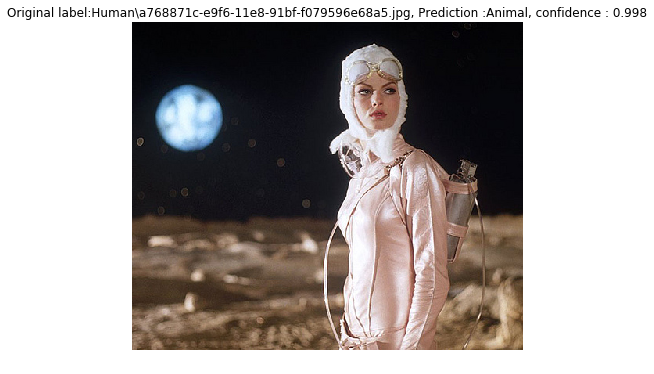

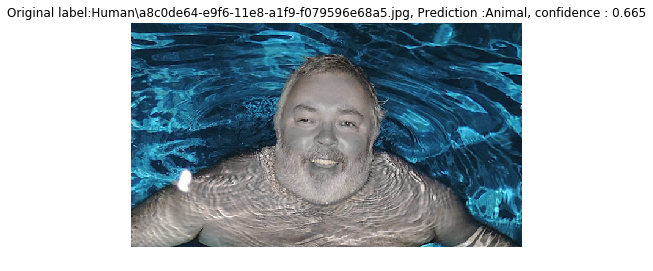

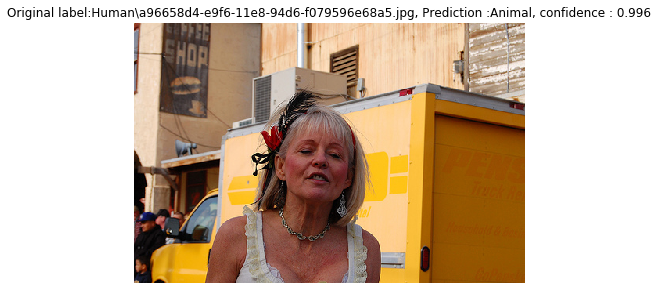

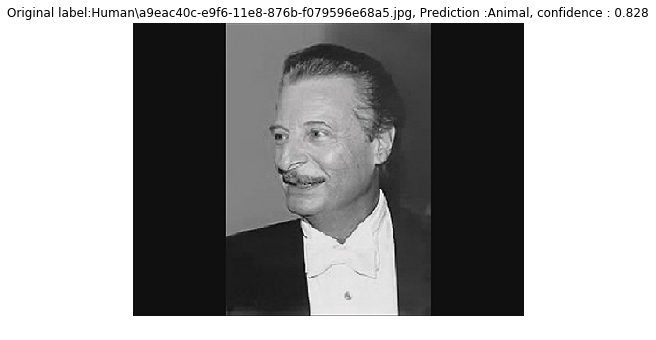

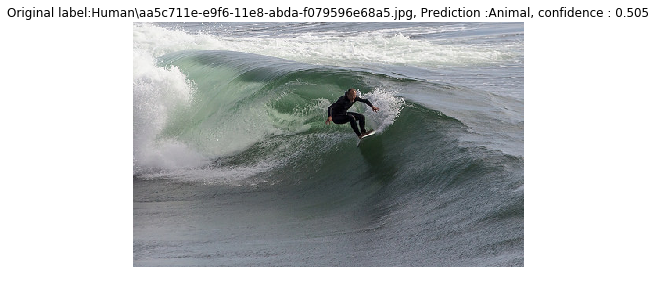

...

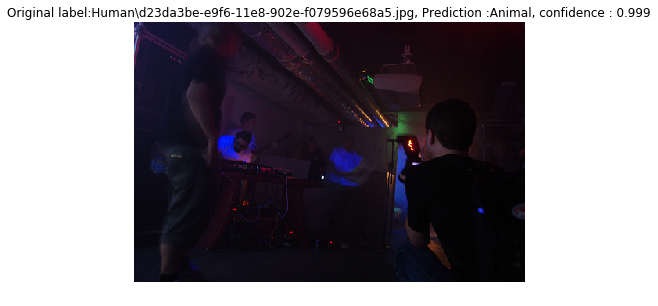

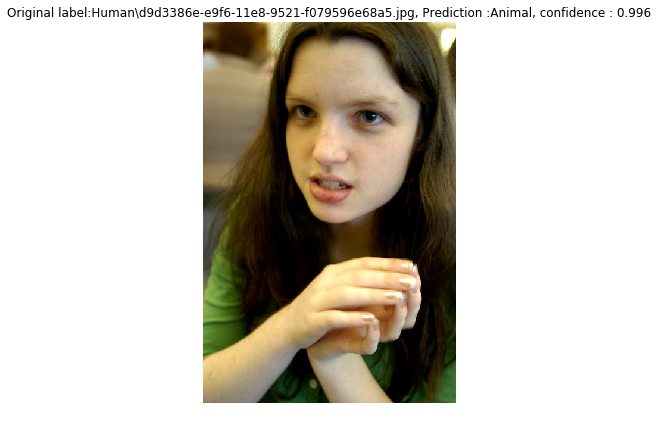

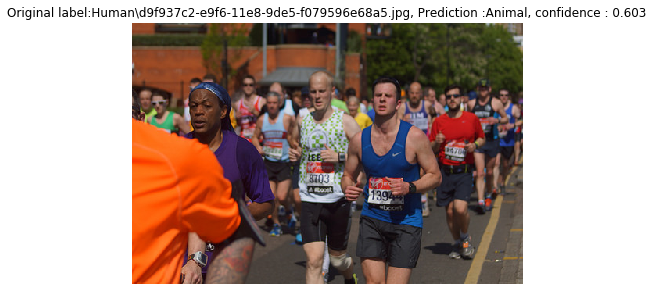

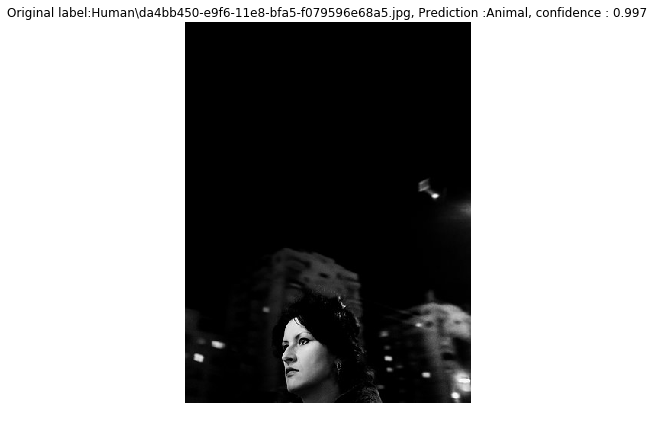

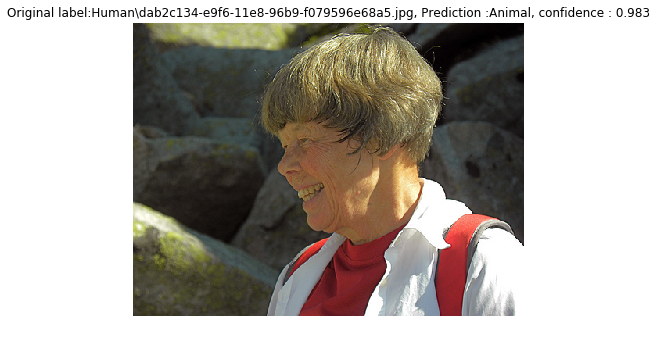

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


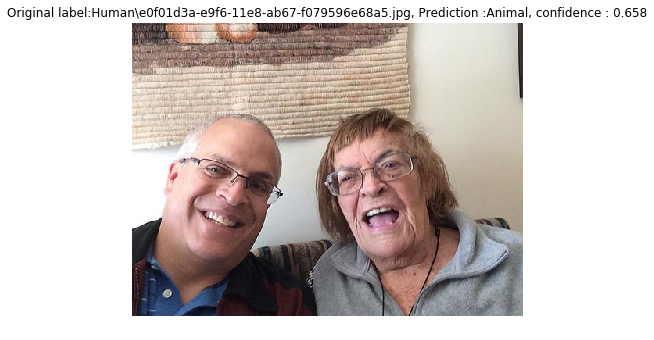

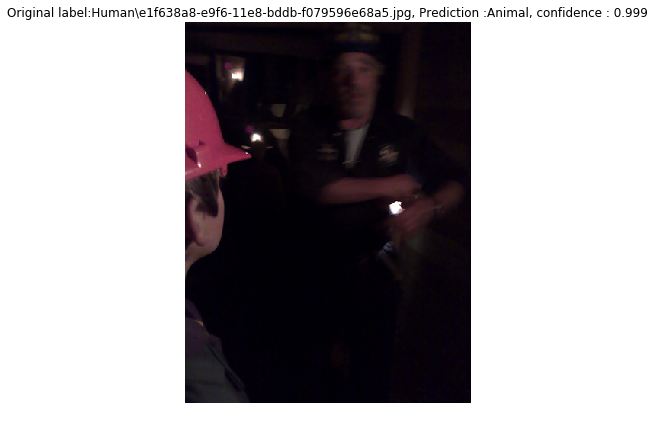

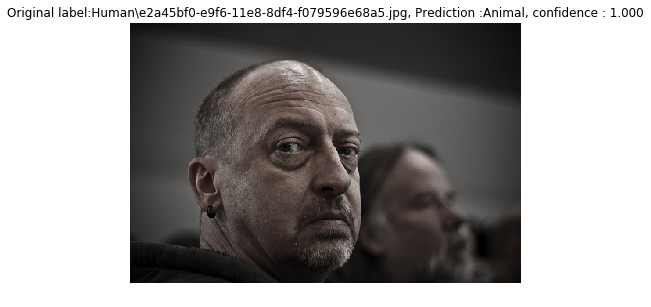

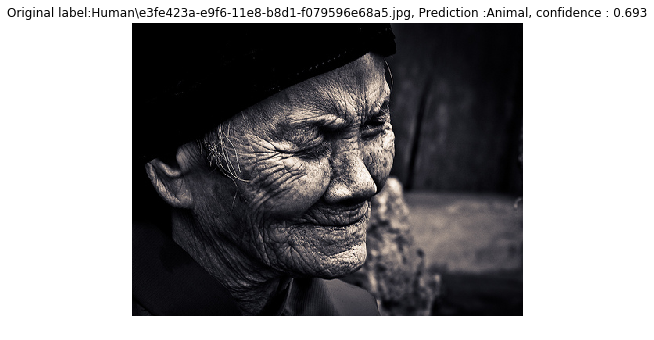

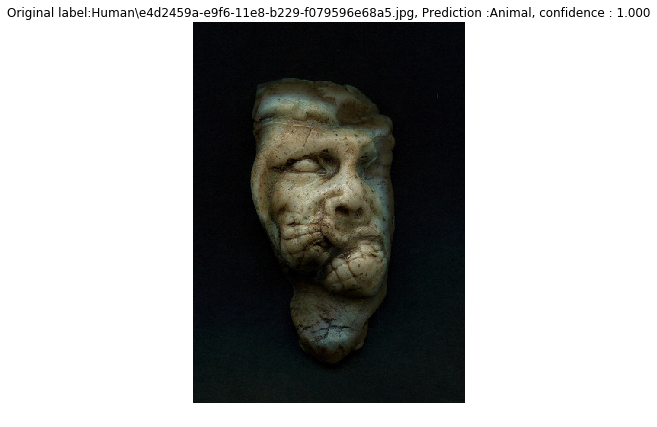

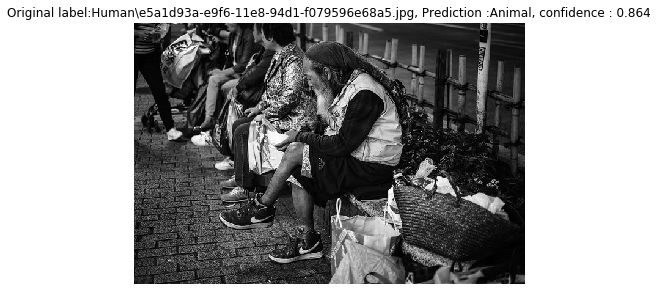

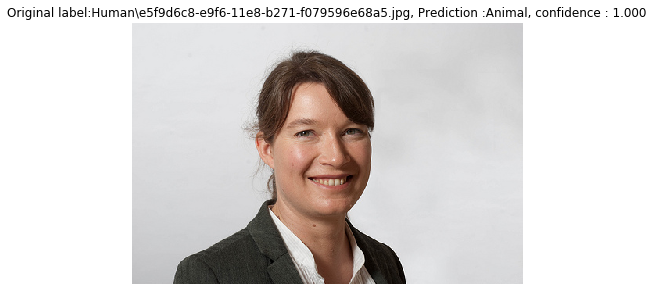

In [23]:
# Get the filenames from the generator
fnames = test_generator.filenames
 
# Get the ground truth from generator
ground_truth = test_generator.classes
 
# Get the label to class mapping from the generator
label2index = test_generator.class_indices
 
# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())
 
# Get the predictions from the model using the generator
predictions = model.predict_generator(test_generator, steps=test_generator.samples/test_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),test_generator.samples))
 
# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
     
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
     
    original = load_img('{}/{}'.format(test_dir,fnames[errors[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()

## Show good predictions

No of good preds = 148/200


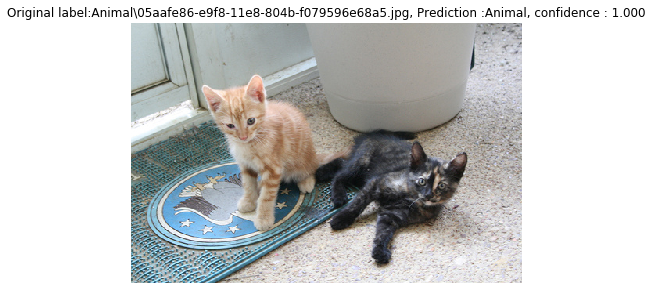

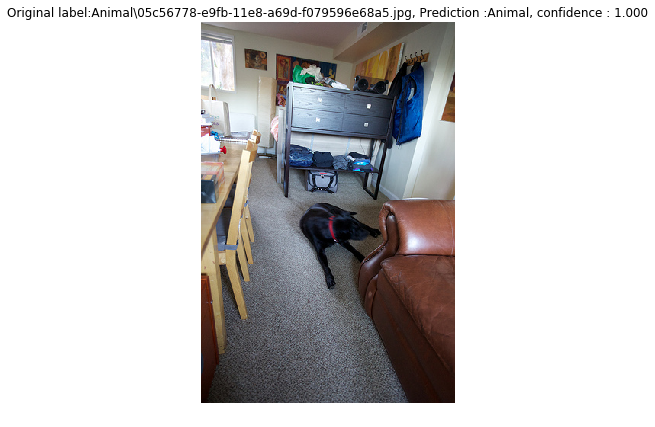

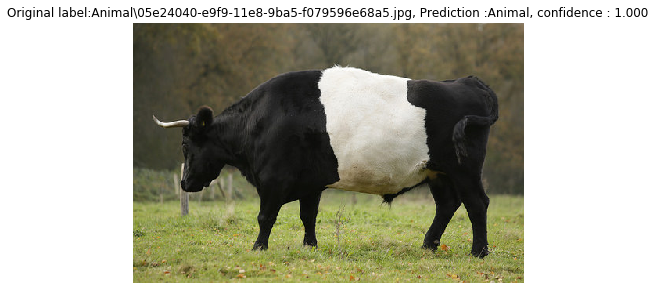

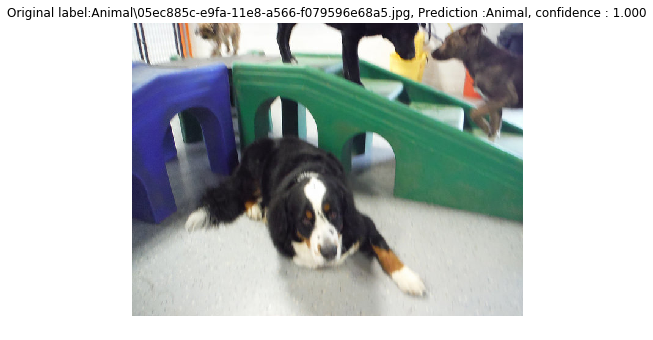

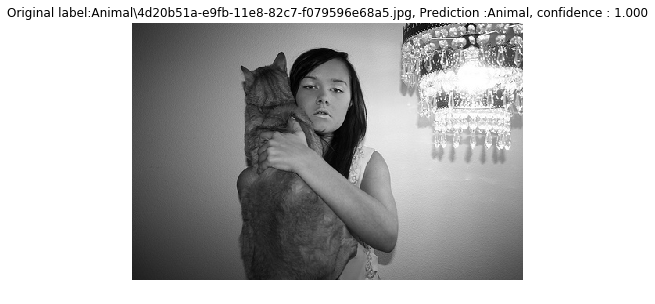

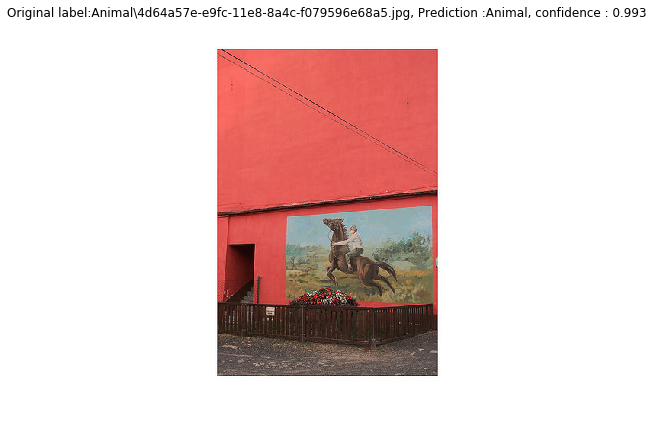

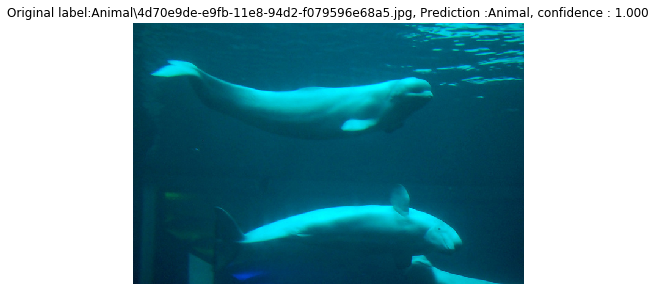

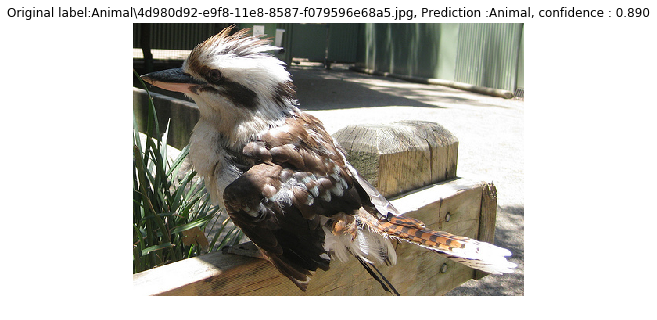

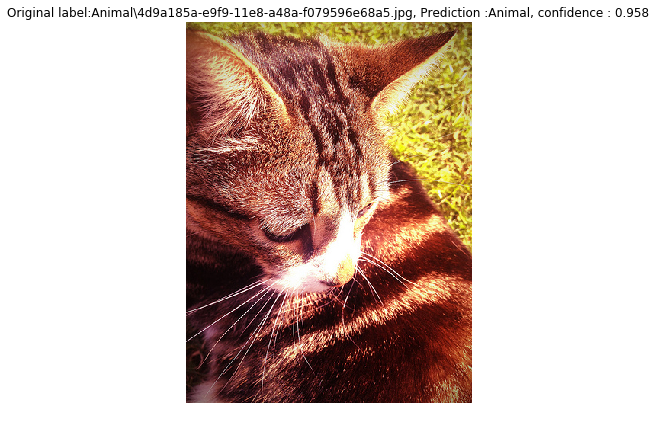

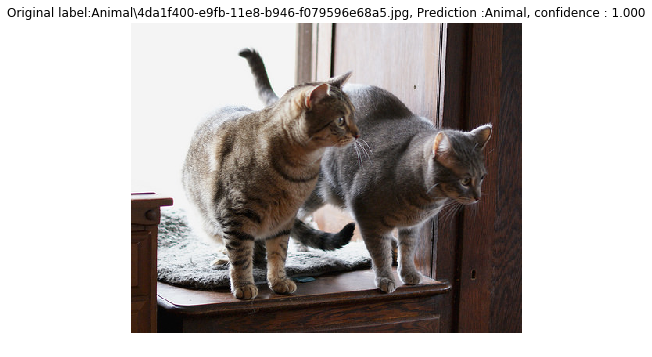

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


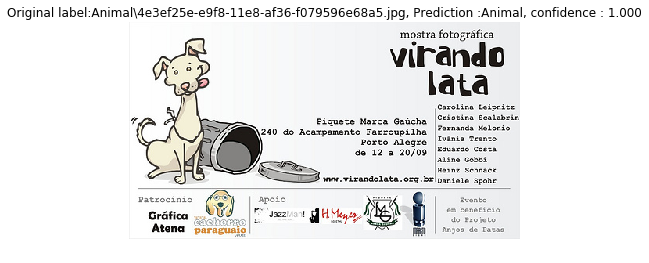

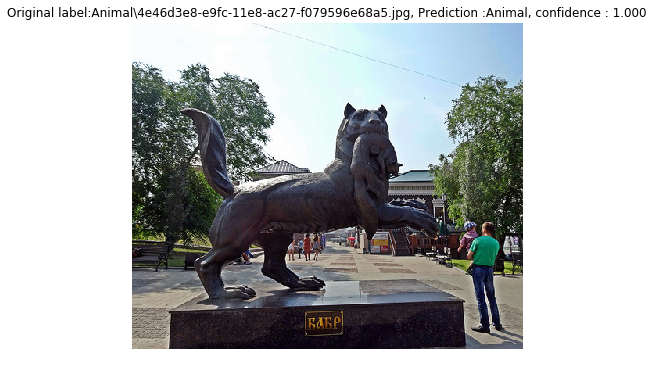

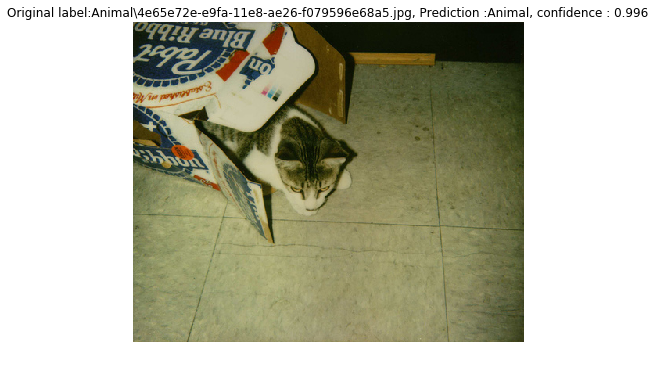

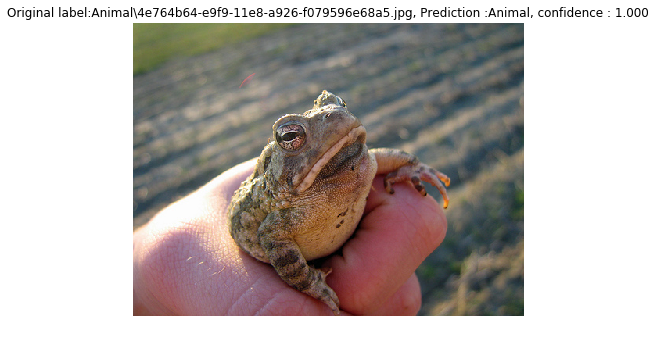

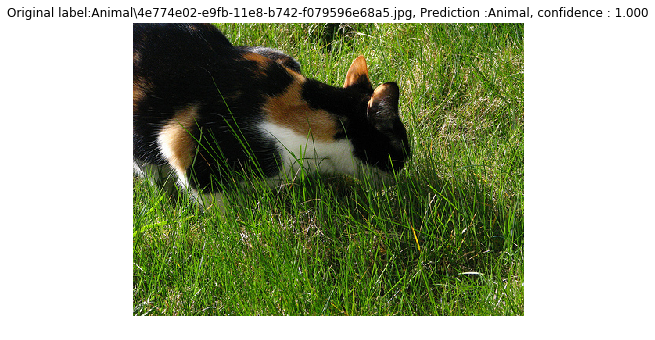

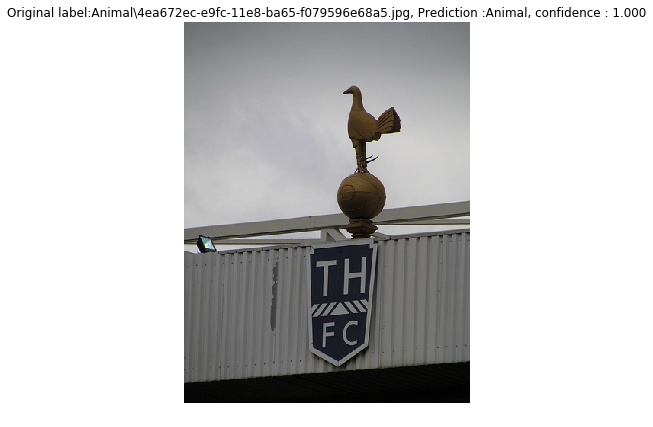

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


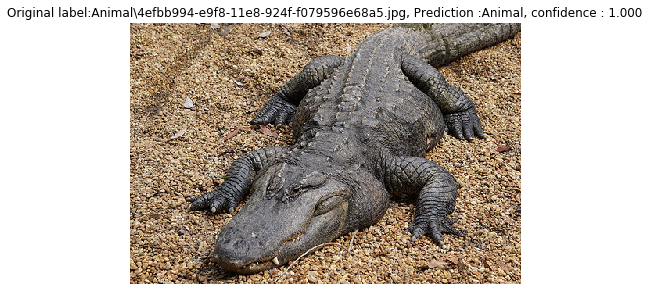

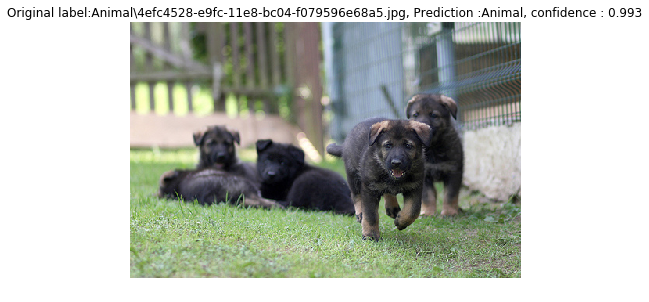

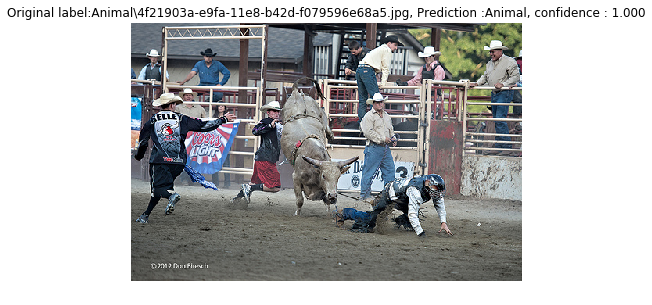

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


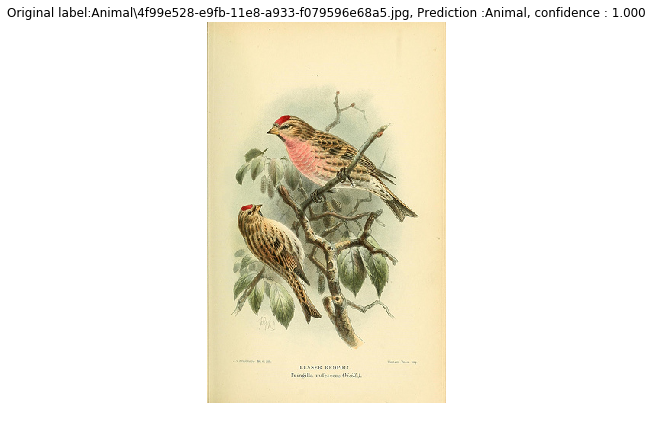

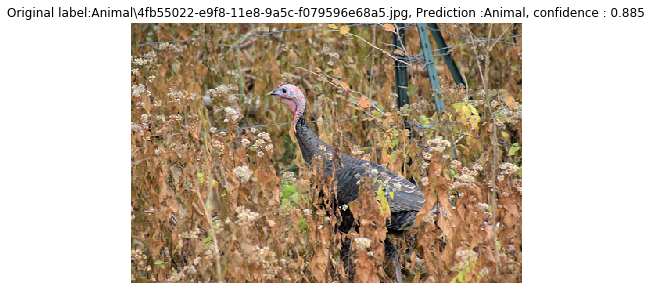

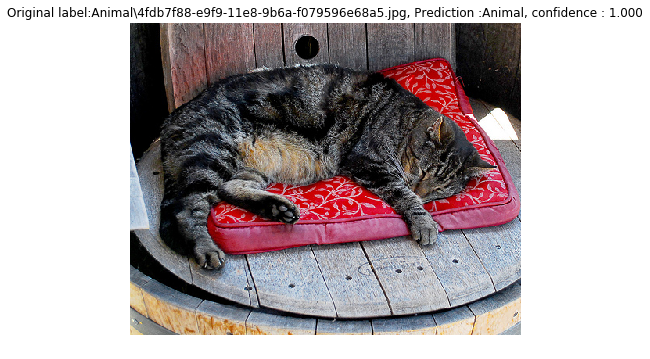

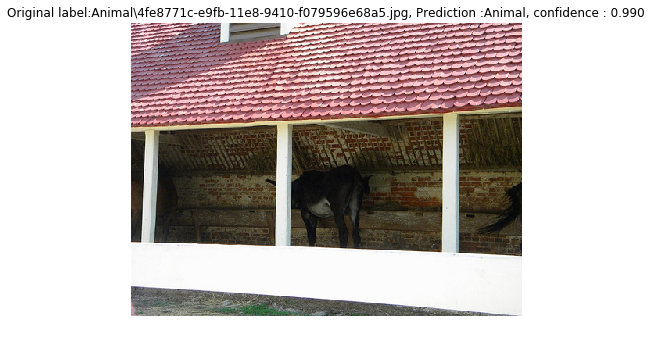

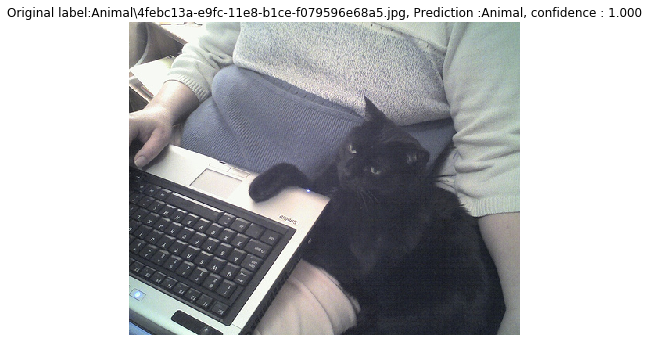

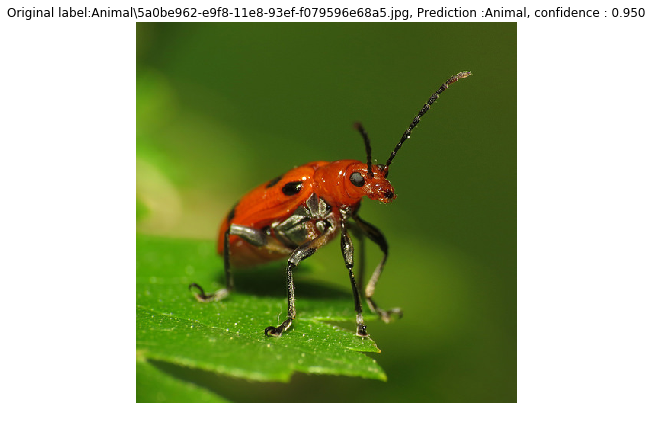

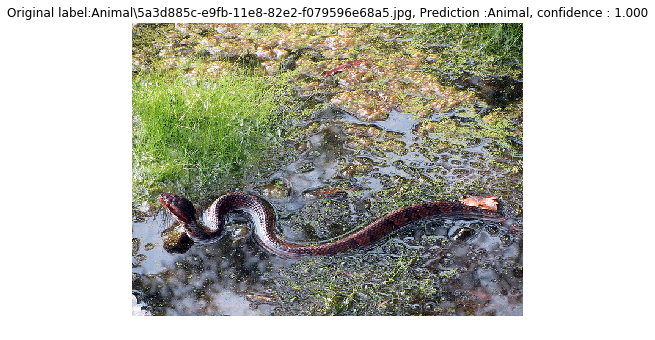

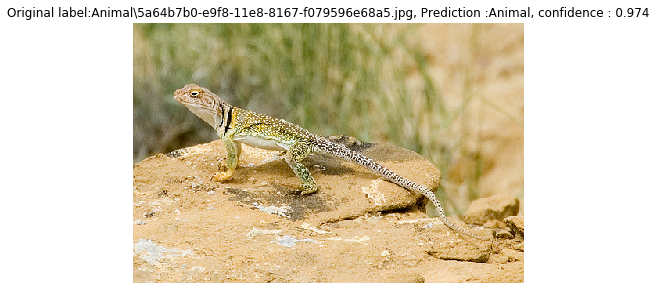

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


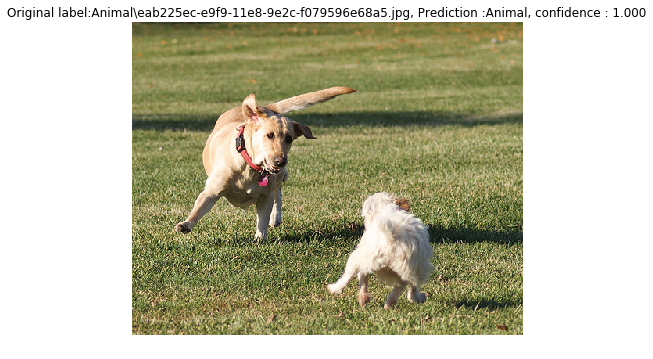

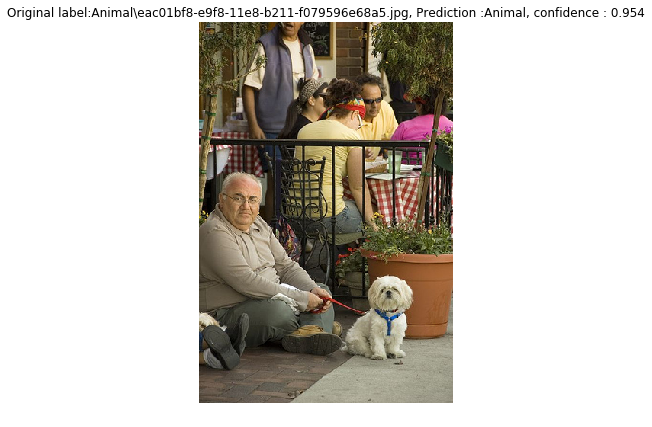

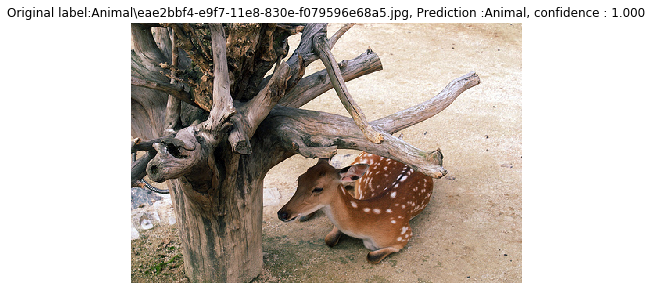

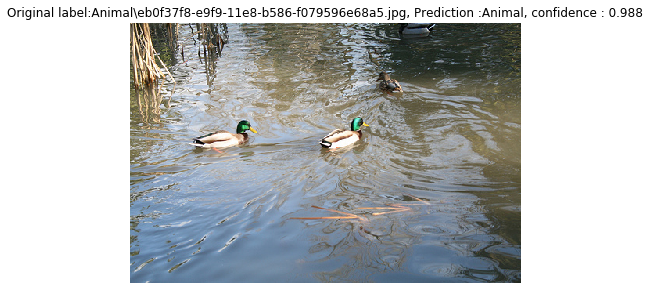

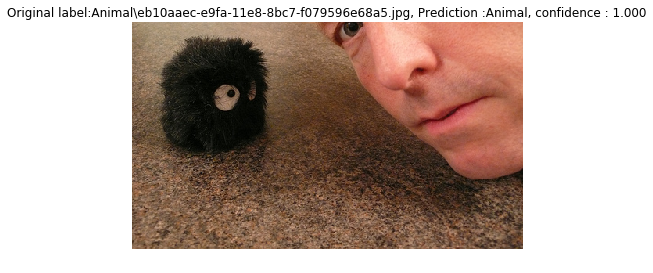

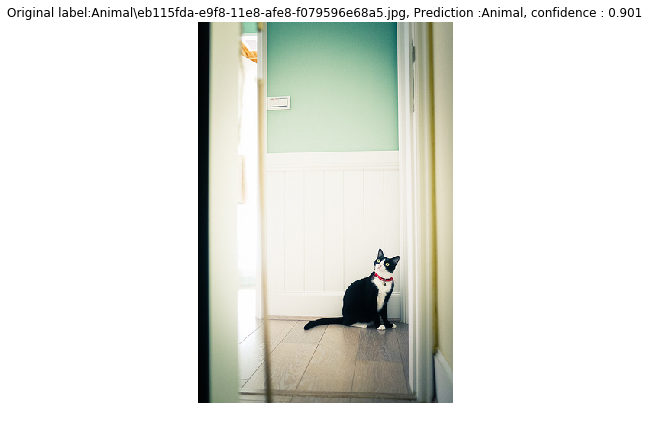

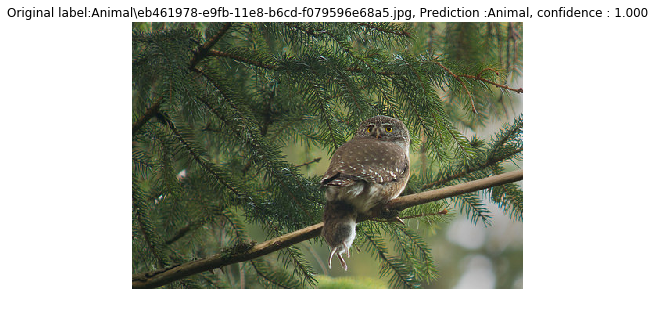

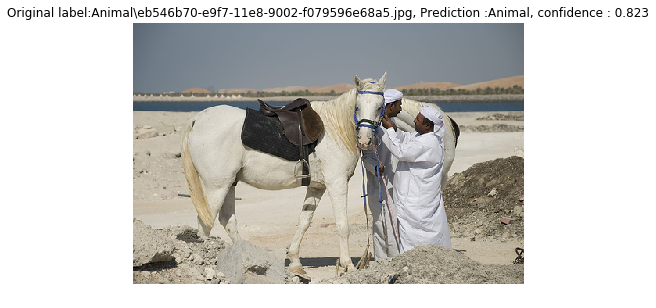

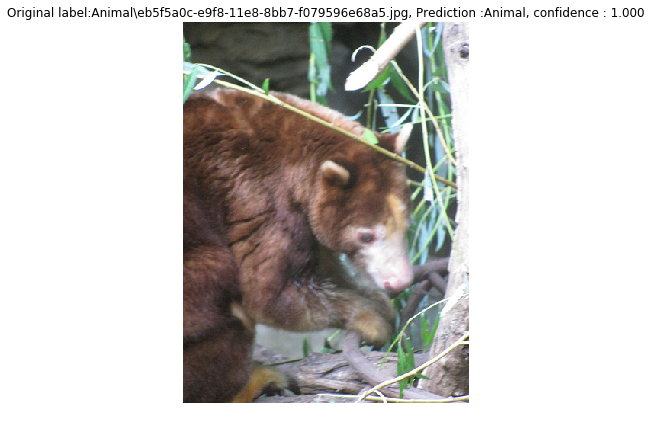

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


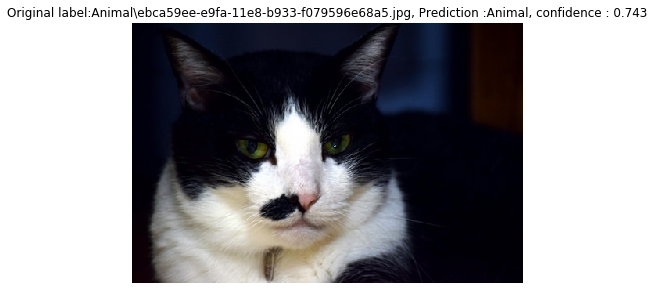

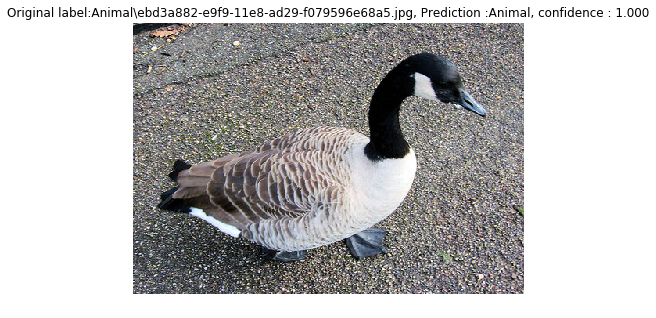

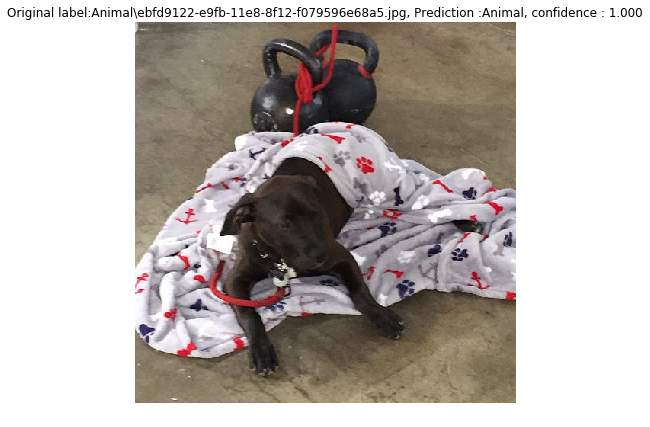

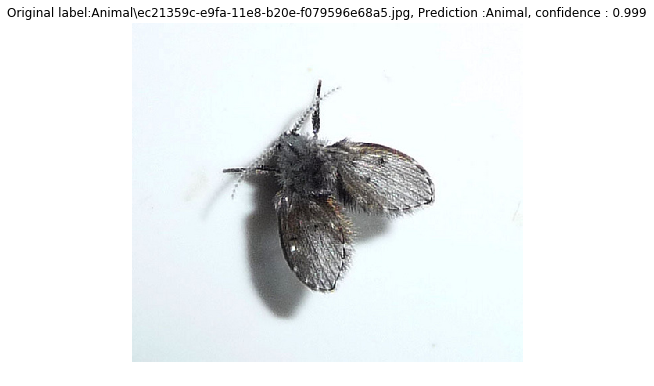

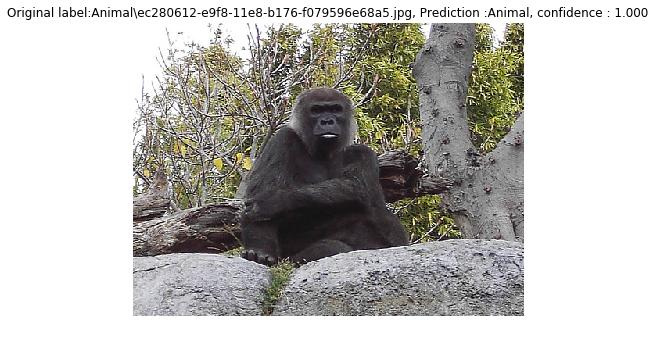

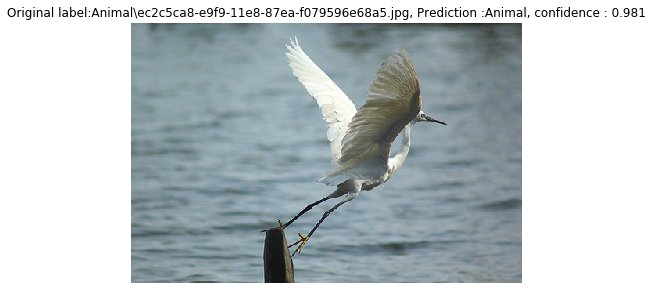

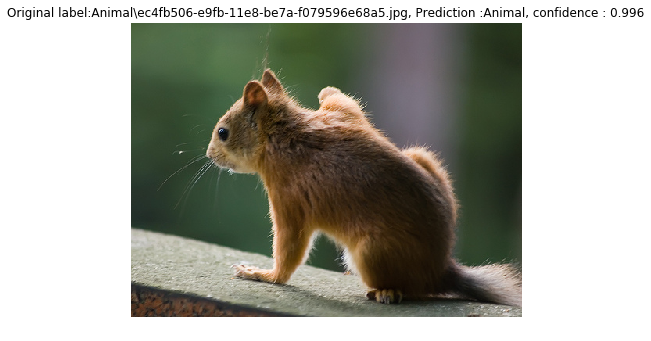

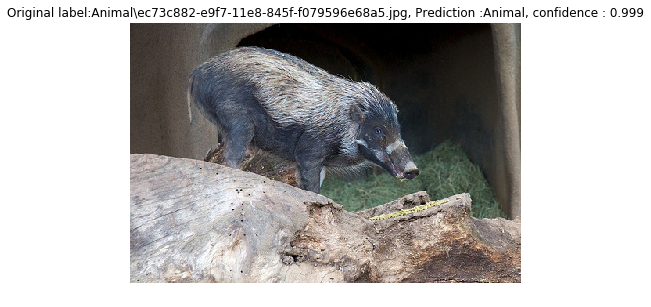

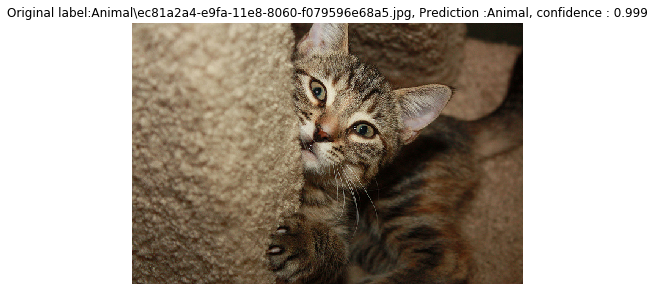

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


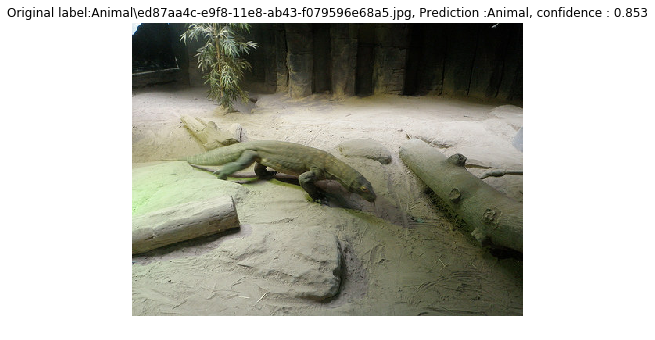

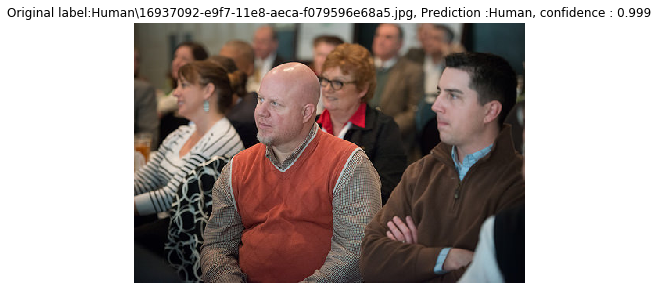

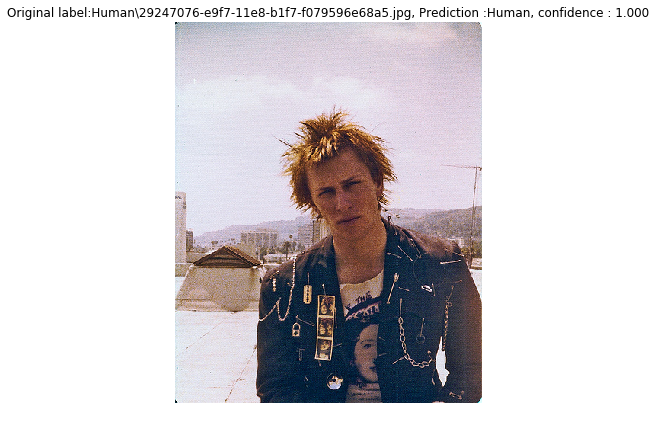

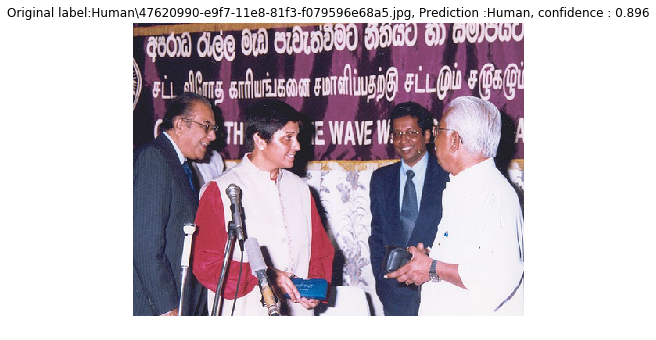

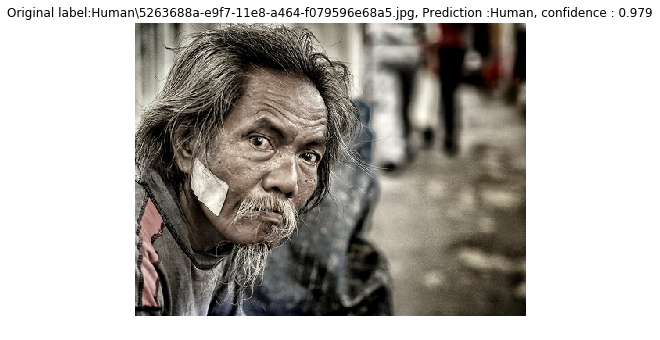

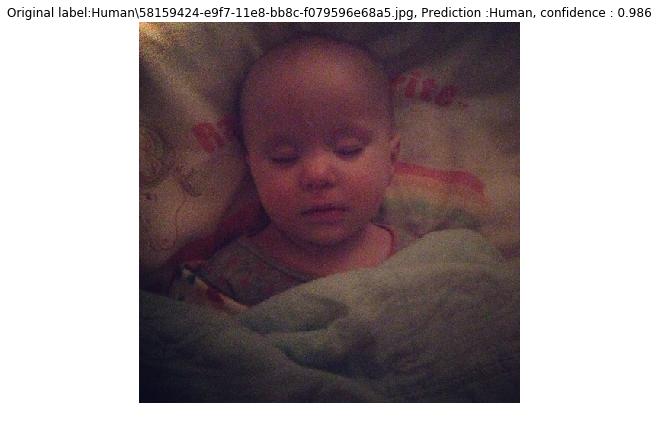

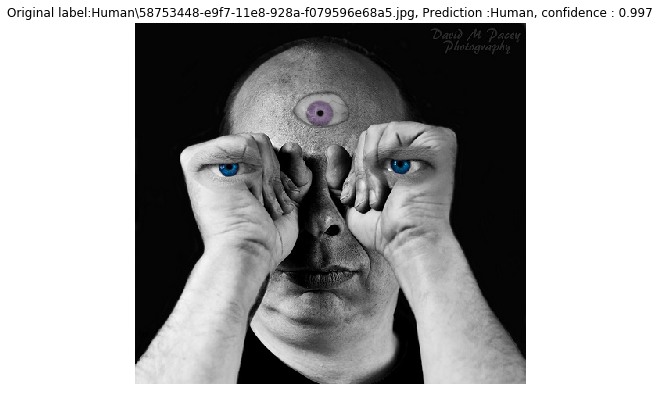

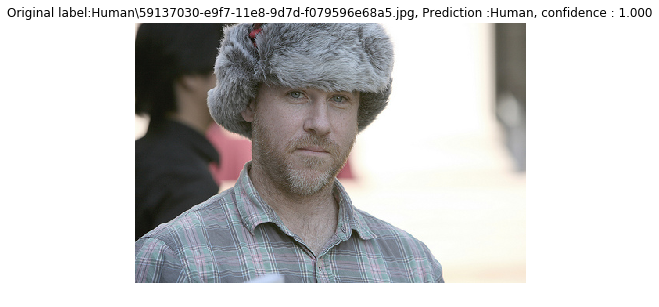

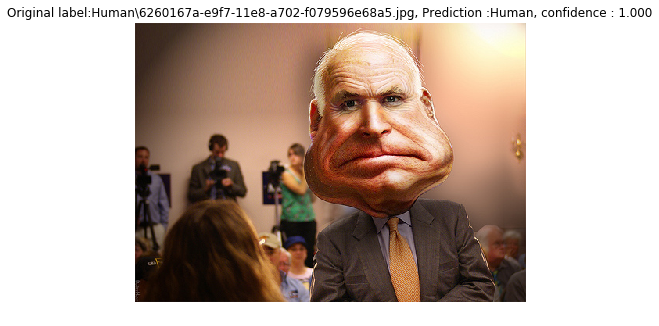

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


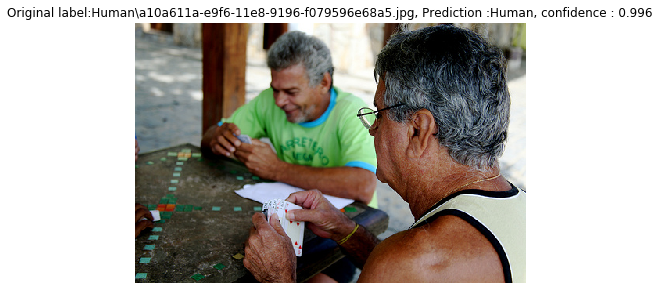

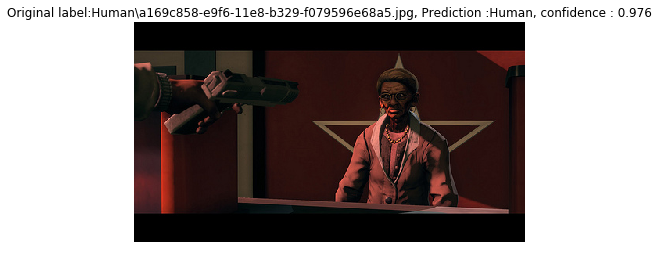

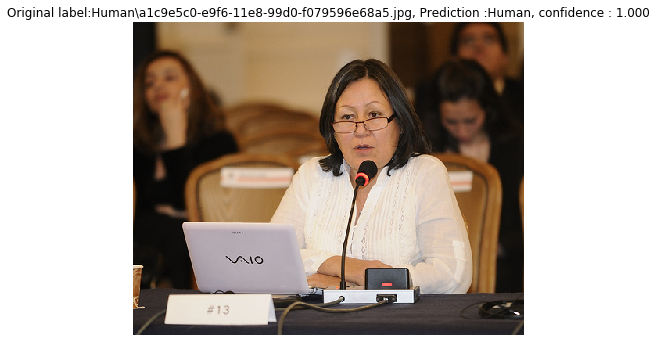

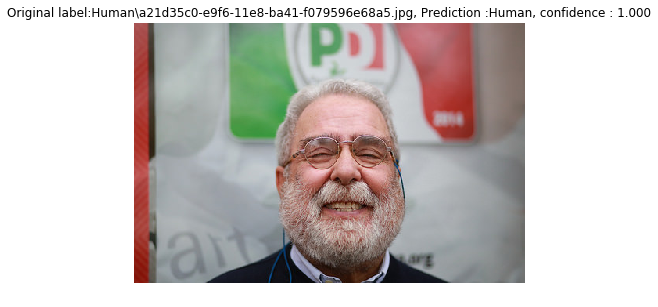

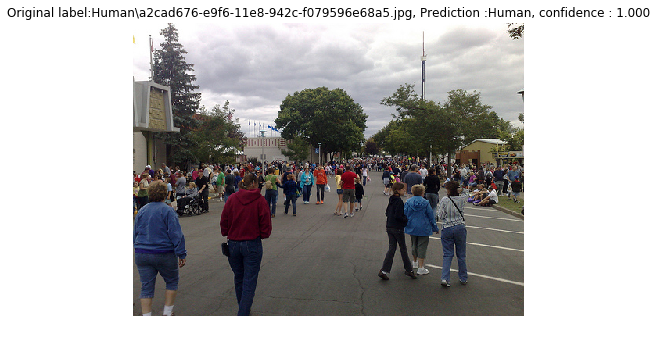

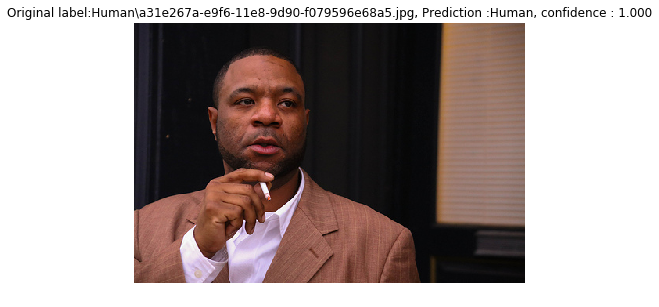

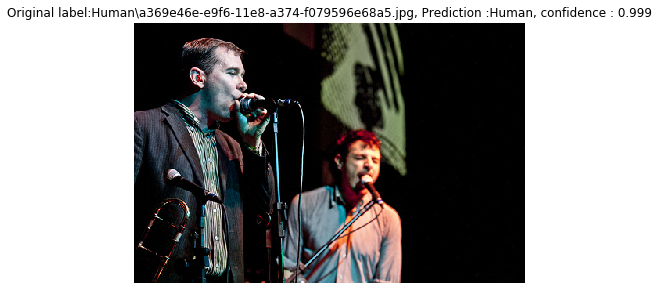

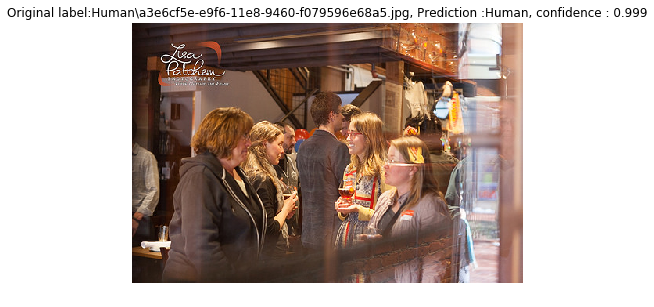

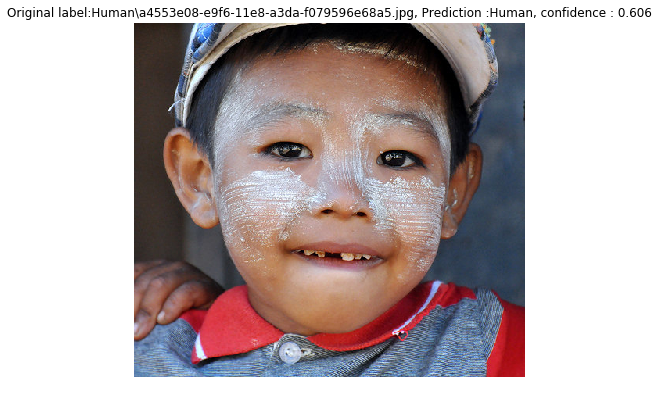

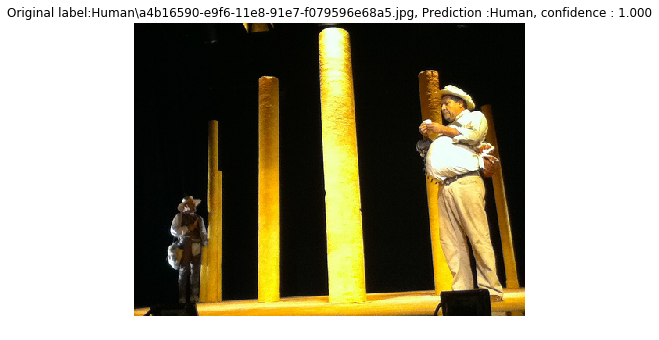

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


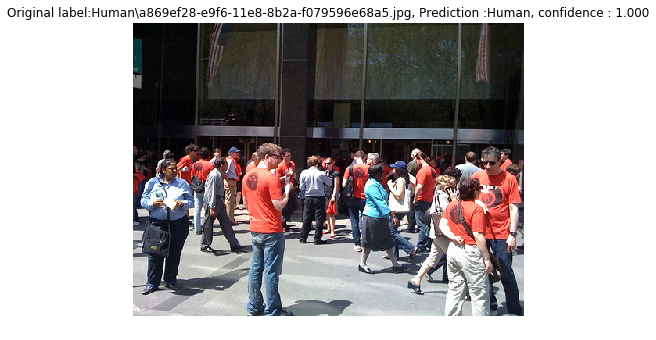

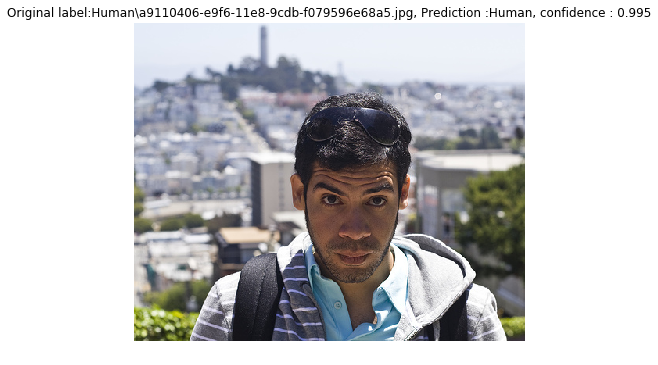

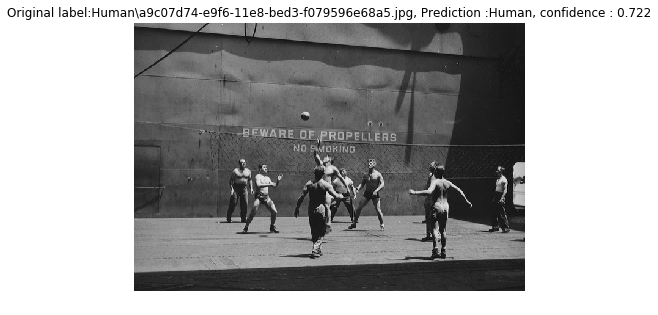

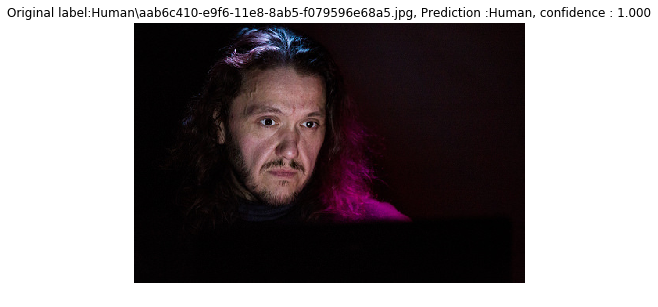

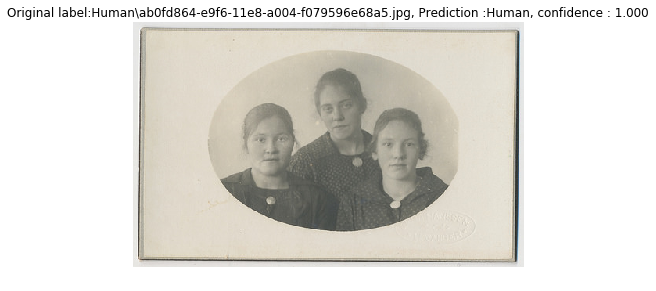

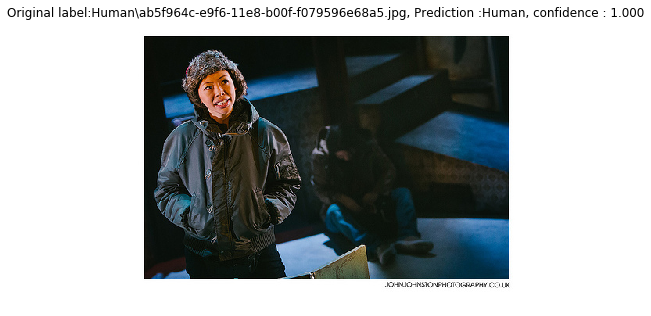

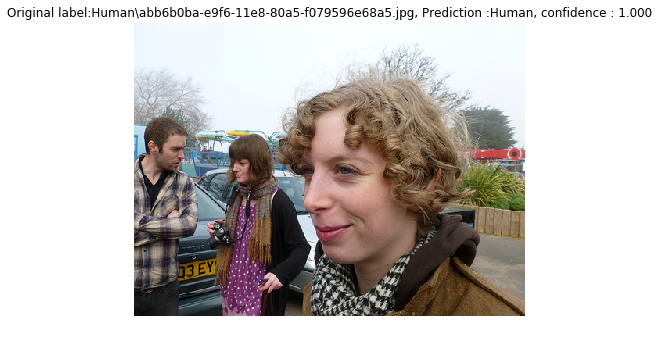

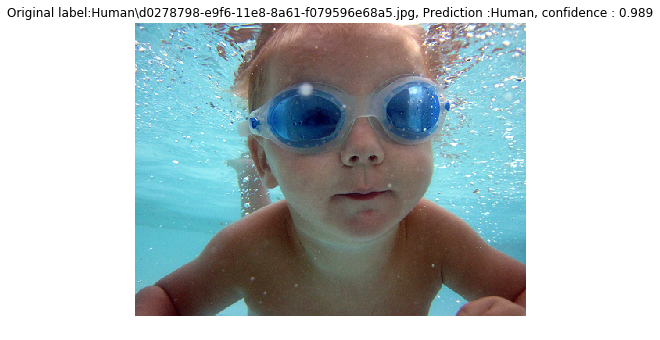

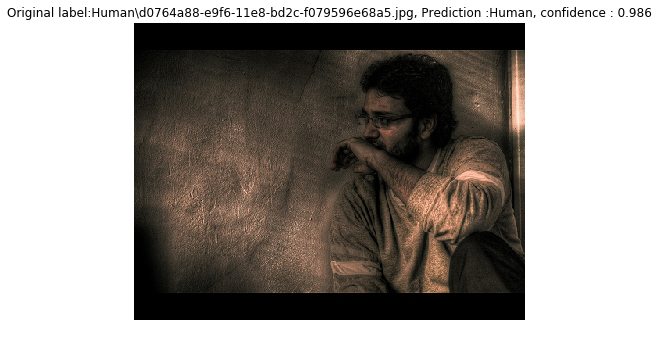

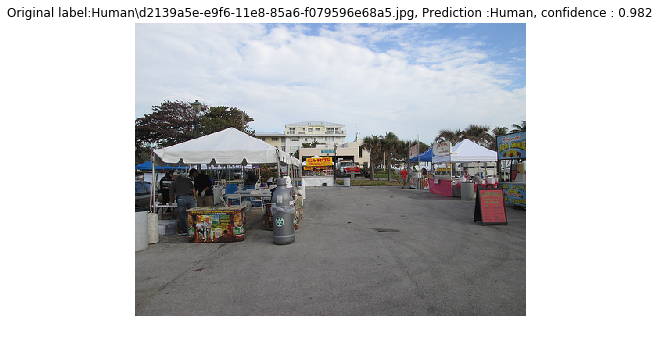

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


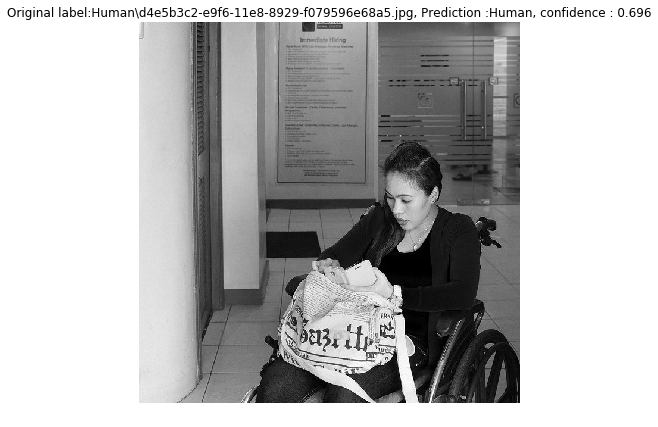

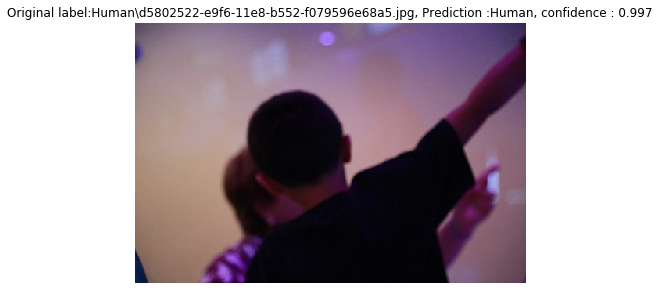

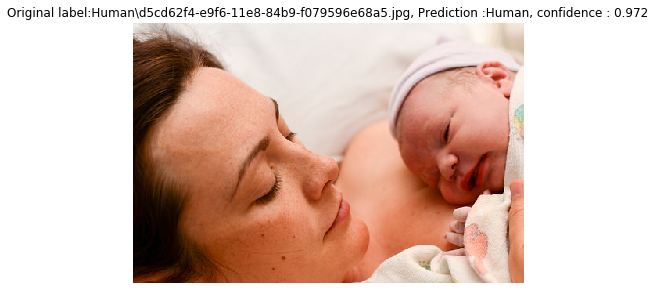

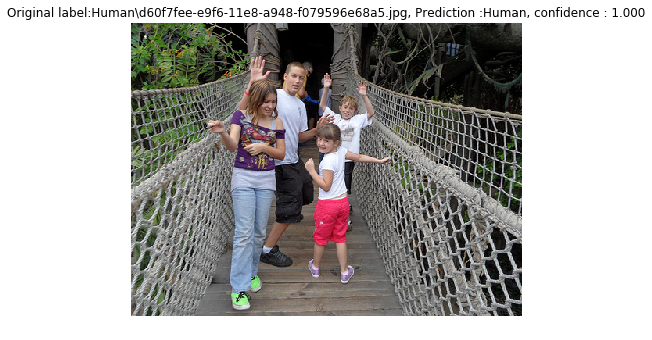

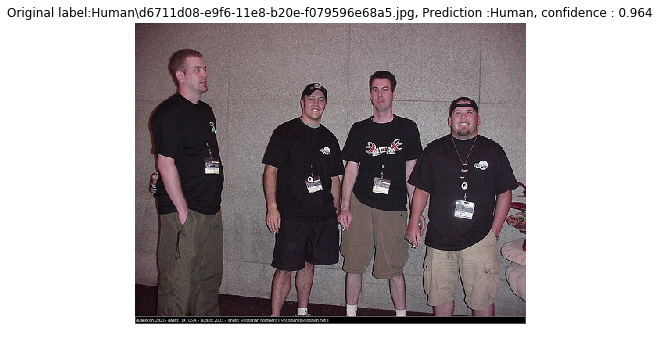

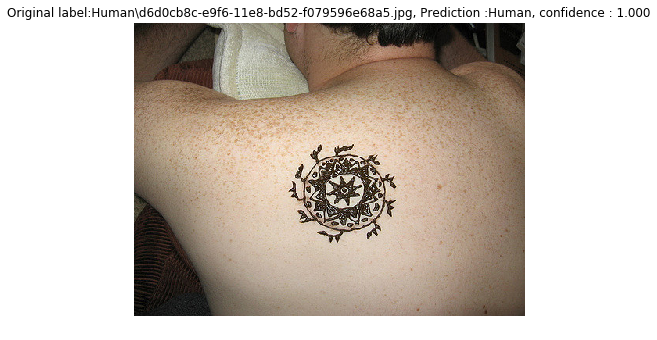

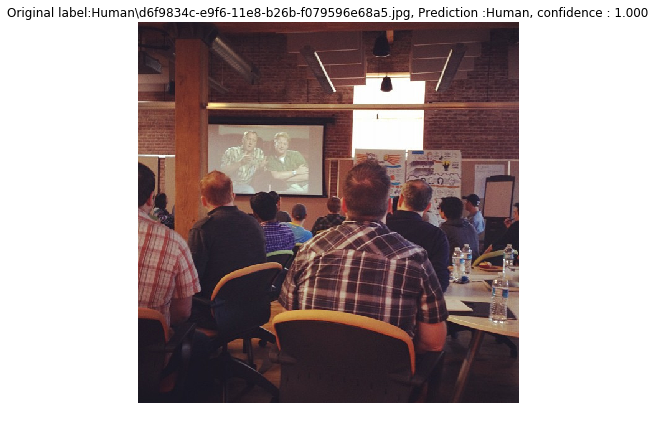

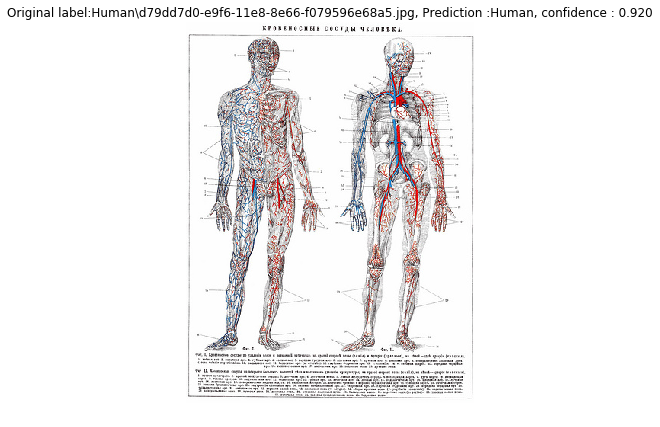

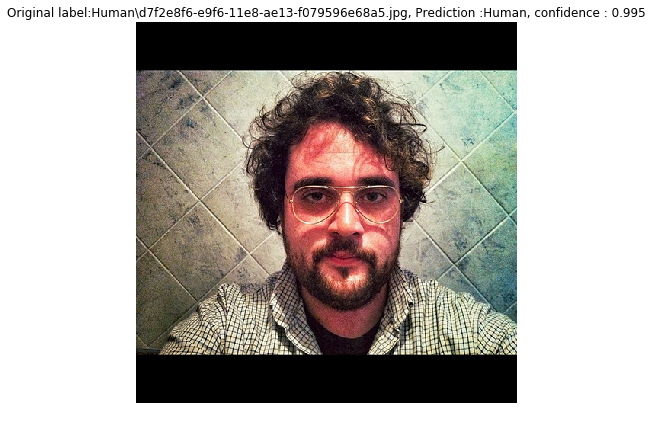

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


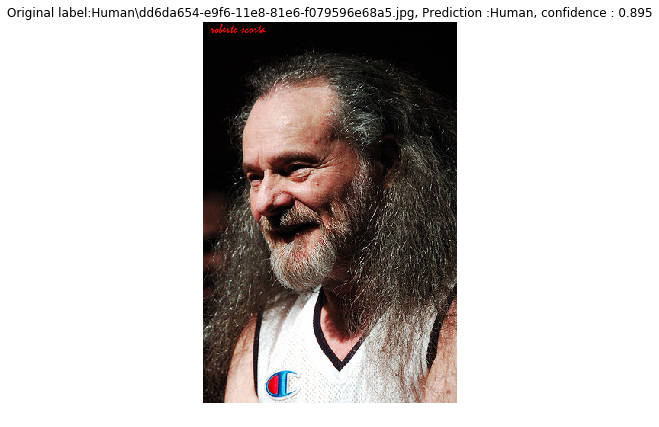

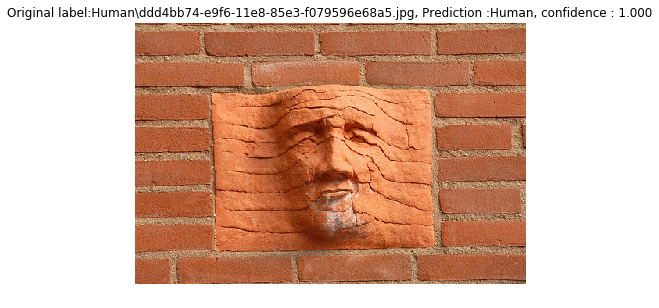

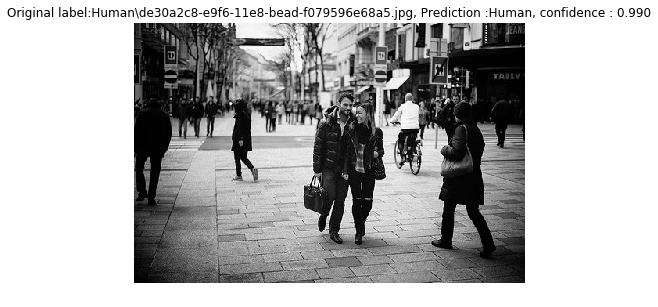

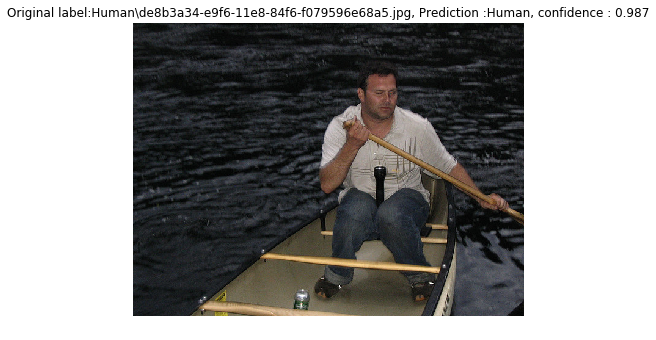

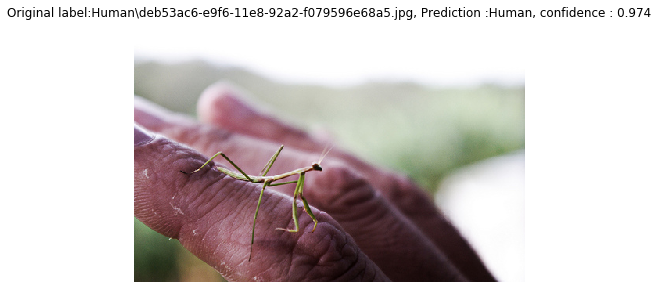

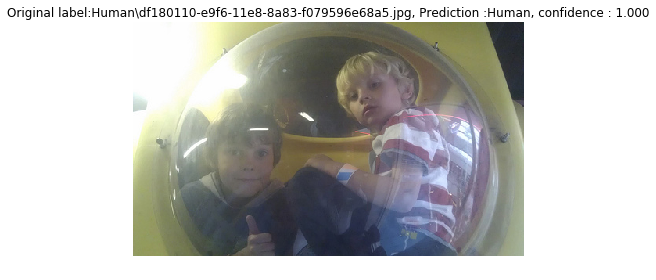

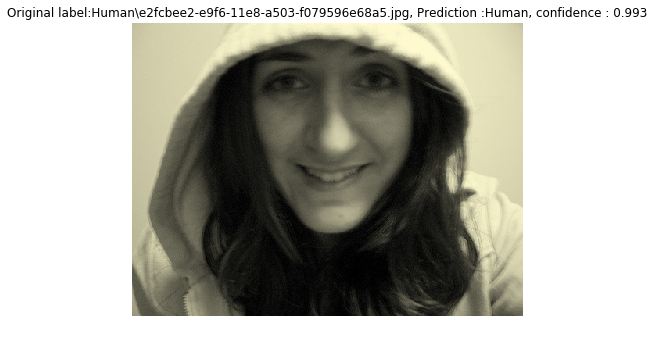

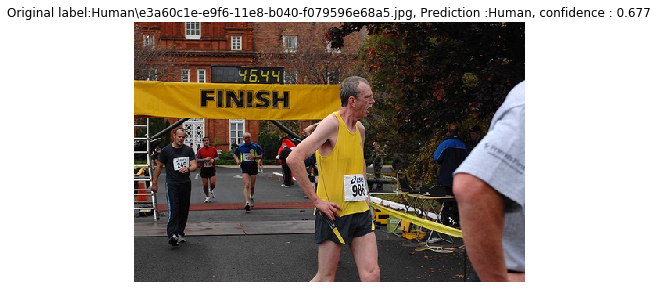

In [25]:
good_preds = np.where(predicted_classes == ground_truth)[0]

print("No of good preds = {}/{}".format(len(good_preds),test_generator.samples))
 
# Show the errors
for i in range(len(good_preds)):
    pred_class = np.argmax(predictions[good_preds[i]])
    pred_label = idx2label[pred_class]
     
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[good_preds[i]].split('/')[0],
        pred_label,
        predictions[good_preds[i]][pred_class])
     
    original = load_img('{}/{}'.format(test_dir,fnames[good_preds[i]]))
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()